In [57]:
import numpy as np
from scipy.io import wavfile
from scipy import signal, fft, io
import matplotlib.pyplot as plt
import IPython

In [58]:
# Memfilter suara dengan lowpass filter dan menyimpan hasilnya
input_file = 'input.wav'  # Ganti dengan file suara input yang diinginkan
output_file = 'output.wav'  # Nama file suara output yang dihasilkan
cutoff_freq = 15000  # Frekuensi cutoff dalam Hz


In [59]:
IPython.display.Audio('./input.wav')

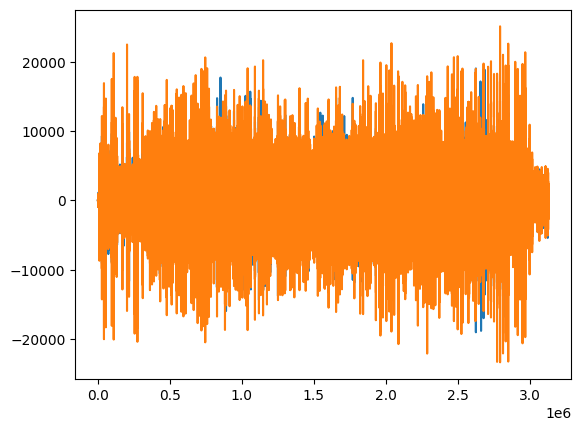

In [60]:
sample_rate, data = wavfile.read(input_file)
plt.plot(data)

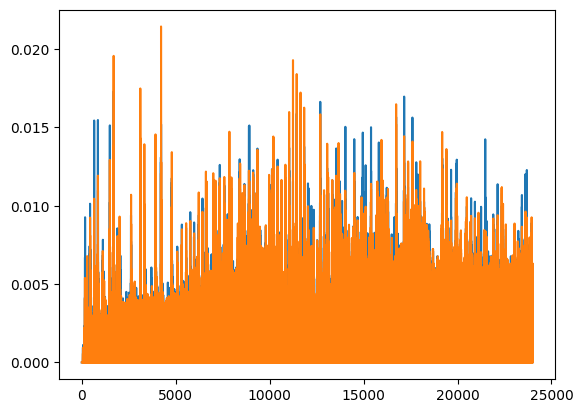

In [61]:
N = len(data)
T = 1. / sample_rate
t = np.linspace(0, N*T, N, endpoint=False)

fft1 = fft.fft(data)
xf = fft.fftfreq(N, T)[:N//2]
plt.plot(xf, 2./N * np.abs(fft1[0:N//2]))

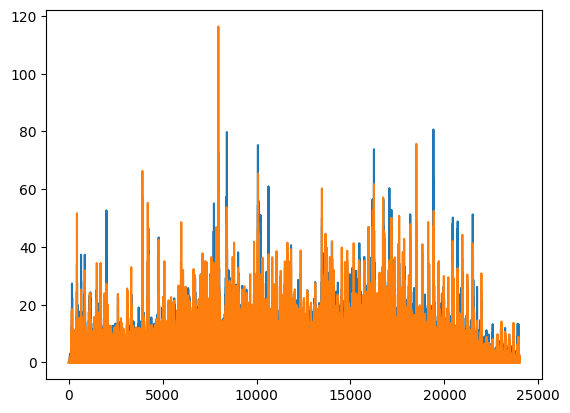

In [62]:
fft1 = fft.fft(data)
xf = fft.fftfreq(N, T)[:N//2]
plt.plot(xf, np.abs(fft1[N//2:])/N * np.abs(fft1[0:N//2]))

(-30.0, 0.0)

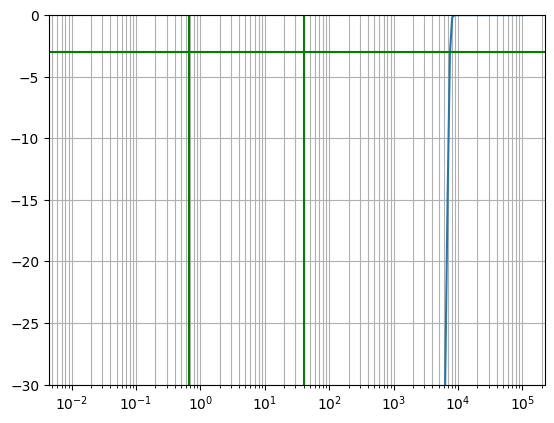

In [63]:
y, x = signal.butter(20, 7500, btype='highpass', analog=True)
w, h = signal.freqs(y, x)
plt.semilogx(w, 20 * np.log10(abs(h)))
plt.axvline(0.67, color='green')
plt.axvline(40, color='green')
plt.axhline(-3, color='green')
plt.grid(which='both', axis='both')
plt.ylim((-30,0))

In [64]:
# Fungsi untuk memfilter suara dengan filter lowpass
def apply_highpass_filter(input_file, output_file, cutoff_freq):
    # Membaca file suara
    sample_rate, data = wavfile.read(input_file)

    # Mengubah data suara menjadi float
    data = data.astype(float)

    # Normalisasi data suara
    data /= np.max(np.abs(data))

    # Mendapatkan koefisien filter
    b, a = get_filter_coefficients('highpass', cutoff_freq, sample_rate)

    # Memfilter data suara
    filtered_data = signal.lfilter(b, a, data)

    # Mengonversi data suara kembali ke integer
    filtered_data = np.int16(filtered_data * 32767)

    # Menyimpan data suara yang sudah difilter ke file baru
    wavfile.write(output_file, sample_rate, filtered_data)

In [65]:

# Fungsi untuk mendapatkan koefisien filter berdasarkan jenis filter dan frekuensi cutoff
def get_filter_coefficients(filter_type, cutoff_freq, sample_rate):
    nyquist_freq = 1.5 * sample_rate

    # Mendapatkan frekuensi normalisasi
    global normalized_cutoff_freq
    normalized_cutoff_freq = cutoff_freq / nyquist_freq

    # Mendapatkan koefisien filter
    b, a = signal.butter(30, normalized_cutoff_freq, btype=filter_type, analog=False)

    return b, a

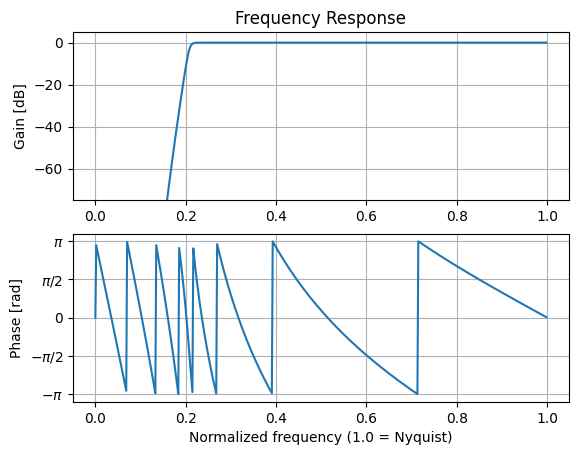

In [66]:
get_filter_coefficients('highpass', cutoff_freq, sample_rate)
sos = signal.butter(30, normalized_cutoff_freq, btype='highpass', output='sos')
w, h = signal.sosfreqz(sos)

plt.subplot(2, 1, 1)
db = 20*np.log10(np.maximum(np.abs(h), 1e-5))
plt.plot(w/np.pi, db)
plt.ylim(-75, 5)
plt.grid(True)
plt.yticks([0, -20, -40, -60])
plt.ylabel('Gain [dB]')
plt.title('Frequency Response')
plt.subplot(2, 1, 2)
plt.plot(w/np.pi, np.angle(h))
plt.grid(True)
plt.yticks([-np.pi, -0.5*np.pi, 0, 0.5*np.pi, np.pi],
           [r'$-\pi$', r'$-\pi/2$', '0', r'$\pi/2$', r'$\pi$'])
plt.ylabel('Phase [rad]')
plt.xlabel('Normalized frequency (1.0 = Nyquist)')
plt.show()

In [67]:
def calculate_fft(input_file):
    # Membaca file suara
    sample_rate, data = wavfile.read(input_file)

    # Mengubah data suara menjadi float
    data = data.astype(float)

    # Normalisasi data suara
    data /= np.max(np.abs(data))

    # Menghitung FFT
    fft_data = np.fft.fft(data)

    # Menghitung magnitude spektrum
    magnitude_spectrum = np.abs(fft_data)

    # Menghitung frekuensi
    frequencies = np.fft.fftfreq(len(data), 1 / sample_rate)

    return frequencies, magnitude_spectrum

In [68]:
apply_highpass_filter(input_file, output_file, cutoff_freq)

In [69]:
# Menghitung FFT dari suara asli
frequencies_orig, magnitude_spectrum_orig = calculate_fft(input_file)

# Menghitung FFT dari suara yang sudah difilter
frequencies_filtered, magnitude_spectrum_filtered = calculate_fft(output_file)


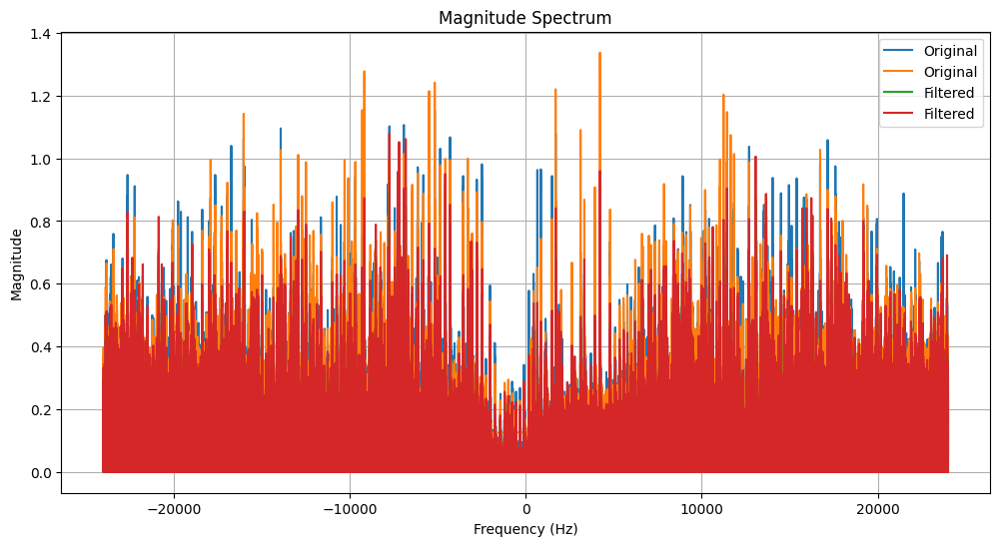

In [70]:
# Menampilkan plot magnitude spektrum
plt.figure(figsize=(12, 6))
plt.plot(frequencies_orig, magnitude_spectrum_orig, label='Original')
plt.plot(frequencies_filtered, magnitude_spectrum_filtered, label='Filtered')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Magnitude')
plt.title('Magnitude Spectrum')
plt.legend()
plt.grid(True)
plt.show()

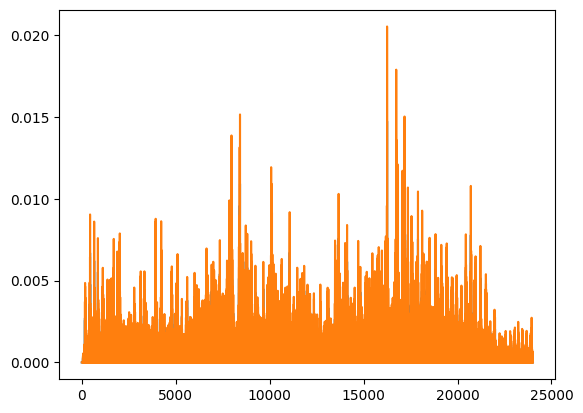

In [71]:
filtered = signal.sosfilt(sos, data)

fft1 = fft.fft(filtered)
xf = fft.fftfreq(N, T)[:N//2]
plt.plot(xf, np.abs(fft1[N//2:])/N * np.abs(fft1[0:N//2]))

In [72]:
IPython.display.Audio('./output.wav')